In [1]:
%cd code

[Errno 2] No such file or directory: 'code'
/d/hpc/projects/FRI/ldragar/code


In [24]:
import os
import numpy as np
import torch


class Result():
    def __init__(self, test1, test2, test3, name, fn1, fn2, fn3, mapping):
        self.test1 = test1
        self.test2 = test2
        self.test3 = test3
        self.name = name
        self.fn1 = fn1
        self.fn2 = fn2
        self.fn3 = fn3
        self.summary = None
        self.weight = None
        self.mae = None
        self.mapping= mapping.copy()

    def set_summary(self, summary):
        self.summary = summary

    def set_weight(self, weight):
        self.weight = weight

def load_predictions(folder, name,filenames=["Test1_preds.txt", "Test2_preds.txt", "Test3_preds.txt"]):
    test1, test2, test3 = [], [], []
    fn1, fn2, fn3 = [], [], []
    mapping = {}

    for i, filename in enumerate(filenames):
        with open(os.path.join(folder, filename)) as file:
            for line in file:
                file_name, test = line.split(",")
                if i == 0:
                    fn1.append(file_name)
                    test1.append(float(test))
                    mapping[file_name] = float(test)
                elif i == 1:
                    fn2.append(file_name)
                    test2.append(float(test))
                    mapping[file_name] = float(test)
                else:
                    fn3.append(file_name)
                    test3.append(float(test))
                    mapping[file_name] = float(test)

    return Result(test1, test2, test3, name, fn1, fn2, fn3, mapping)


def load_predictions_all(folder, name,filenames=["Test1_preds.txt", "Test2_preds.txt", "Test3_preds.txt"]):
    test1, test2, test3 = [], [], []
    fn1, fn2, fn3 = [], [], []
    mapping = {}

    for i, filename in enumerate(filenames):
        with open(os.path.join(folder, filename)) as file:
            for line in file:
                data = line.split(",")
                file_name = data[0]
                all_preds = [float(x) for x in data[1:] if x != "\n"]

                if i == 0:
                    fn1.append(file_name)
                    test1.append(all_preds)
                    # mapping[file_name].append(all_preds)
                elif i == 1:
                    fn2.append(file_name)
                    test2.append(all_preds)
                    # mapping[file_name].append(all_preds)
                else:
                    fn3.append(file_name)
                    test3.append(all_preds)
                    # mapping[file_name].append(all_preds)

        

    return Result(test1, test2, test3, name, fn1, fn2, fn3, mapping)

# Define your paths and parameters here
eva_prediction_folder = "./eva_models/37orwro0/dotren_ema37orwro0_final_modl_10_avgpreds/"
convnext_prediction_folder = "./convnext_models/y23waiez/dotren_convy23waiez_final_modl_10_avgpreds/"
competition_end_groundthrought_folder = "./competition_end_groundtruth/"
my_submission_folder = "./submition/"
new_submission_folder = "./results/qj0iryy1/"
new_submission_folder_all_frames = "./testpreds3/qj0iryy1/-1/"

ok_eva = "./predictions/yuuy96l4/-1"
ok_convnext = "./predictions/d7h0ubl1/-1"




eva_prediction = load_predictions(eva_prediction_folder, "eva")
convnext_prediction = load_predictions(convnext_prediction_folder, "convnext")
competition_end_groundthrought = load_predictions(competition_end_groundthrought_folder, "groundtruth", ["Test1-labels.txt", "Test2-labels.txt", "Test3-labels.txt"])
submission = load_predictions(my_submission_folder, "submission", ["Test1_preds.txt", "Test2_preds.txt", "Test3_preds.txt"])
new_submission = load_predictions(new_submission_folder, "new_submission", ["Test1_preds.txt", "Test2_preds.txt", "Test3_preds.txt"])
new_submission_all_frames = load_predictions(new_submission_folder_all_frames, "new_submission_all_frames", ["Test1_preds.txt", "Test2_preds.txt", "Test3_preds.txt"])
new_sub_all_lowest_Score = load_predictions("./testpreds3/qj0iryy1/-1/", "new_sub_all_lowest_Score", ["lowest_Test1_preds.txt", "lowest_Test2_preds.txt", "lowest_Test3_preds.txt"])
std_beetwen_frames = load_predictions("./testpreds3/qj0iryy1/-1/", "std_beetwen_frames", ["std_beetwen_frames_Test1_preds.txt", "std_beetwen_frames_Test2_preds.txt", "std_beetwen_frames_Test3_preds.txt"])
all_frames = load_predictions_all("./testpreds3/qj0iryy1/-1/", "all_frames", ["frame_predictions_Test1_preds.txt", "frame_predictions_Test2_preds.txt", "frame_predictions_Test3_preds.txt"])

conv_frames = load_predictions("./predictions/47qukgop/-1/", "conv_frames", ["Test1_preds.txt", "Test2_preds.txt", "Test3_preds.txt"])
eva_frames = load_predictions("./predictions/vgmu4sbz/-1/", "eva_frames", ["Test1_preds.txt", "Test2_preds.txt", "Test3_preds.txt"])

conv_all_frames = load_predictions_all("./predictions/47qukgop/-1/", "conv_all_frames", ["frame_predictions_Test1_preds.txt", "frame_predictions_Test2_preds.txt", "frame_predictions_Test3_preds.txt"])
eva_all_frames = load_predictions_all("./predictions/vgmu4sbz/-1/", "eva_all_frames", ["frame_predictions_Test1_preds.txt", "frame_predictions_Test2_preds.txt", "frame_predictions_Test3_preds.txt"])

ok_eva_frames = load_predictions(ok_eva, "ok_eva_frames", ["Test1_preds.txt", "Test2_preds.txt", "Test3_preds.txt"])
ok_convnext_frames = load_predictions(ok_convnext, "ok_convnext_frames", ["Test1_preds.txt", "Test2_preds.txt", "Test3_preds.txt"])



print(f"Loaded Eva prediction with {len(eva_prediction.test1)+len(eva_prediction.test2)+len(eva_prediction.test3)} samples")
print(f"Loaded ConvNext prediction with {len(convnext_prediction.test1)+len(convnext_prediction.test2)+len(convnext_prediction.test3)} samples")
print(f"Loaded groundtruth with {len(competition_end_groundthrought.test1)+len(competition_end_groundthrought.test2)+len(competition_end_groundthrought.test3)} samples")
print(f"Loaded submission with {len(submission.test1)+len(submission.test2)+len(submission.test3)} samples")
print(f"Loaded new_submission with {len(new_submission.test1)+len(new_submission.test2)+len(new_submission.test3)} samples")
print(f"Loaded new_submission_all_frames with {len(new_submission_all_frames.test1)+len(new_submission_all_frames.test2)+len(new_submission_all_frames.test3)} samples")

assert len(eva_prediction.test1) == len(convnext_prediction.test1)
assert len(eva_prediction.test2) == len(convnext_prediction.test2)
assert len(eva_prediction.test3) == len(convnext_prediction.test3)
assert len(eva_prediction.test1) == len(competition_end_groundthrought.test1)
assert len(eva_prediction.test2) == len(competition_end_groundthrought.test2)
assert len(eva_prediction.test3) == len(competition_end_groundthrought.test3)


eva_test = [np.array(eva_prediction.test1), np.array(eva_prediction.test2), np.array(eva_prediction.test3)]
convnext_test = [np.array(convnext_prediction.test1), np.array(convnext_prediction.test2), np.array(convnext_prediction.test3)]
groundtruth_test = [np.array(competition_end_groundthrought.test1), np.array(competition_end_groundthrought.test2), np.array(competition_end_groundthrought.test3)]
submission_test = [np.array(submission.test1), np.array(submission.test2), np.array(submission.test3)]
new_submission_test = [np.array(new_submission.test1), np.array(new_submission.test2), np.array(new_submission.test3)]
new_submission_all_frames_test = [np.array(new_submission_all_frames.test1), np.array(new_submission_all_frames.test2), np.array(new_submission_all_frames.test3)]
new_sub_all_lowest_Score_test = [np.array(new_sub_all_lowest_Score.test1), np.array(new_sub_all_lowest_Score.test2), np.array(new_sub_all_lowest_Score.test3)]
std_beetwen_frames_test = [np.array(std_beetwen_frames.test1), np.array(std_beetwen_frames.test2), np.array(std_beetwen_frames.test3)]
eva_frames_test = [np.array(eva_frames.test1), np.array(eva_frames.test2), np.array(eva_frames.test3)]
conv_frames_test = [np.array(conv_frames.test1), np.array(conv_frames.test2), np.array(conv_frames.test3)]

ok_eva_frames_test = [np.array(ok_eva_frames.test1), np.array(ok_eva_frames.test2), np.array(ok_eva_frames.test3)]
ok_convnext_frames_test = [np.array(ok_convnext_frames.test1), np.array(ok_convnext_frames.test2), np.array(ok_convnext_frames.test3)]



#combine eva


#round to 0 decimal
# eva_test = [np.round(eva_test[0],1), np.round(eva_test[1],1), np.round(eva_test[2],1)]
# convnext_test = [np.round(convnext_test[0],1), np.round(convnext_test[1],1), np.round(convnext_test[2],1)]
# groundtruth_test = [np.round(groundtruth_test[0],1), np.round(groundtruth_test[1],1), np.round(groundtruth_test[2],1)]
# submission_test = [np.round(submission_test[0],1), np.round(submission_test[1],1), np.round(submission_test[2],1)]
# new_submission_test = [np.round(new_submission_test[0],1), np.round(new_submission_test[1],1), np.round(new_submission_test[2],1)]
# new_submission_all_frames_test = [np.round(new_submission_all_frames_test[0],1), np.round(new_submission_all_frames_test[1],1), np.round(new_submission_all_frames_test[2],1)]


#combineine eva and convnext with weights of 0.75 convnext and 0.25 eva
combined_predictions = [0.25*eva_test[0]+0.75*convnext_test[0], 0.25*eva_test[1]+0.75*convnext_test[1], 0.25*eva_test[2]+0.75*convnext_test[2]]
w=0.5
new_combined_predictions = [w*eva_test[0]+(1-w)*new_submission_all_frames_test[0], w*eva_test[1]+(1-w)*new_submission_all_frames_test[1], w*eva_test[2]+(1-w)*new_submission_all_frames_test[2]]
frames_combined_predictions = [w*eva_frames_test[0]+(1-w)*conv_frames_test[0], w*eva_frames_test[1]+(1-w)*conv_frames_test[1], w*eva_frames_test[2]+(1-w)*conv_frames_test[2]]
#combined and sub
combined_ok = [w*ok_eva_frames_test[0]+(1-w)*ok_convnext_frames_test[0], w*ok_eva_frames_test[1]+(1-w)*ok_convnext_frames_test[1], w*ok_eva_frames_test[2]+(1-w)*ok_convnext_frames_test[2]]



Loaded Eva prediction with 700 samples
Loaded ConvNext prediction with 700 samples
Loaded groundtruth with 700 samples
Loaded submission with 700 samples
Loaded new_submission with 700 samples
Loaded new_submission_all_frames with 700 samples


In [3]:
#plot coorelation beetwen std beetwen frames and rmse beetwen predictions
#use plotly to plot the test1 of convnet and eva and groundtruth
import plotly.graph_objects as go
import plotly.express as px



#get rmse beetwen new_submission_all_frames_test and groundtruth_test
def get_rmse(predictions, groundtruth):
    return np.abs(predictions-groundtruth)


import numpy as np
from scipy.stats import linregress

def plot_correlation(x, y, title, xaxis_title, yaxis_title):
    fig = go.Figure()
    fig.add_trace(go.Scatter(x=x, y=y, mode='markers', name='markers'))

    # Compute the linear regression
    slope, intercept, _, _, _ = linregress(x, y)
    line_x = np.linspace(min(x), max(x), 100)
    line_y = slope * line_x + intercept
    fig.add_trace(go.Scatter(x=line_x, y=line_y, mode='lines', name='correlation line'))

    fig.update_layout(title=title, xaxis_title=xaxis_title, yaxis_title=yaxis_title)
    fig.show()

# Assuming that your data is structured with multiple tests
for test_num in range(3): # Define number_of_tests based on your data
    x_values = std_beetwen_frames_test[test_num]
    y_values = [get_rmse(new_submission_all_frames_test[test_num][i], groundtruth_test[test_num][i]) for i in range(len(new_submission_all_frames_test[test_num]))]
    
    plot_correlation(x_values, y_values, f"Correlation between std between frames and RMSE between predictions for Test {test_num}", "std between frames", "rmse between predictions")



In [13]:
#plot coorelation beetwen std beetwen frames and rmse beetwen predictions
#use plotly to plot the test1 of convnet and eva and groundtruth
import plotly.graph_objects as go
import plotly.express as px



#get rmse beetwen new_submission_all_frames_test and groundtruth_test
def get_rmse(predictions, groundtruth):
    return np.abs(predictions-groundtruth)


import numpy as np
from scipy.stats import linregress

def plot_correlation(x, y, title, xaxis_title, yaxis_title):
    fig = go.Figure()
    fig.add_trace(go.Scatter(x=x, y=y, mode='markers', name='markers' ))

    # Compute the linear regression
    slope, intercept, r_value, p_value, std_err  = linregress(x, y)
    line_x = np.linspace(min(x), max(x), 100)
    line_y = slope * line_x + intercept
    fig.add_trace(go.Scatter(x=line_x, y=line_y, mode='lines', name='correlation line'))

    fig.update_layout(title=title, xaxis_title=xaxis_title, yaxis_title=yaxis_title,yaxis=dict(range=[1, 5]))
    #add r2 and p value
    fig.add_annotation(
            x=1,
            y=1,
            text=f"r2: {r_value**2:.2f}, p: {p_value:.2f}",
            showarrow=False,
            yshift=10
        )

    fig.show()

# Assuming that your data is structured with multiple tests
for test_num in range(3): # Define number_of_tests based on your data
    x_values = std_beetwen_frames_test[test_num]
    y_values = [groundtruth_test[test_num][i] for i in range(len(new_submission_all_frames_test[test_num]))]
    
    plot_correlation(x_values, y_values, f"Correlation between std between frames and MOS for Test {test_num}", "std between frames", "rmse between predictions")



In [91]:
from matplotlib import cm
import numpy as np

fig = go.Figure()

# Assuming all_frames.test2 is a list of samples, and groundtruth_test.test2 is the corresponding ground truth
for sample_num, sample in enumerate(all_frames.test2[20:50]):
    avg = np.mean(sample)
    sample = np.array(sample)
    groundtruth_sample = competition_end_groundthrought.test2[sample_num]
    error = np.sqrt(np.mean((sample - groundtruth_sample) ** 2)) # RMSE

    # Normalize error to a range between 0 and 1 for color mapping (you may need to adjust this)
    normalized_error = error / 2 # You need to define max_error_value based on your data

    # Convert to a color using a hot colormap
    color = cm.get_cmap('hot')(normalized_error)

    # Convert color from RGBA to HEX
    hex_color = '#%02x%02x%02x' % (int(color[0] * 255), int(color[1] * 255), int(color[2] * 255))

    fig.add_trace(go.Scatter(x=np.arange(len(sample)), y=sample, mode='lines', line=dict(color=hex_color), name=f'Sample {sample_num}'))

fig.update_layout(title="Sample of predictions for Test 2", xaxis_title="frame", yaxis_title="prediction")
fig.show()



/tmp/ipykernel_3510401/2216300560.py:17: MatplotlibDeprecationWarning:

The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.



In [97]:
from matplotlib import cm
import numpy as np


# Lists to store the error and standard deviation for each sample
errors = []
std_devs = []

# Assuming all_frames.test2 and competition_end_groundthrought.test2 are lists of samples
for sample_num, sample in enumerate(all_frames.test2):
    sample = np.array(sample)
    groundtruth_sample = competition_end_groundthrought.test2[sample_num]

    # Calculate the error (RMSE) for this sample
    error = np.sqrt(np.mean((sample - groundtruth_sample) ** 2))
    errors.append(error)

    # Calculate the standard deviation for this sample
    std_dev = np.std(sample)
    std_devs.append(std_dev)

# Now create a Plotly scatter plot to visualize the correlation
fig = go.Figure()
fig.add_trace(go.Scatter(x=std_devs, y=errors, mode='markers', name='markers'))

# Optionally, you can also add a line of best fit
slope, intercept, r_value, p_value, std_err = linregress(std_devs, errors)
line_x = np.linspace(min(std_devs), max(std_devs), 100)
line_y = slope * line_x + intercept
print(f"Line of best fit: y = {slope} * x + {intercept}")
print(f"R^2: {r_value ** 2}")
print(f"p-value: {p_value}")

fig.add_trace(go.Scatter(x=line_x, y=line_y, mode='lines', name='Best Fit Line'))

fig.update_layout(title="Correlation between Error of Prediction and Std Deviation in Frames", xaxis_title="Standard Deviation", yaxis_title="Error of Prediction")
fig.show()



Line of best fit: y = 1.0762290543522877 * x + 0.18876358184733086
R^2: 0.2048122984265292
p-value: 1.5251176382365587e-15


In [98]:
# Assuming all_frames.test2 and competition_end_groundthrought.test2 are lists of samples
for sample_num, sample in enumerate(all_frames.test1[:20]):
    sample = np.array(sample)
    groundtruth_sample = competition_end_groundthrought.test1[sample_num]

    # Calculate the mean for this sample
    mean = np.mean(sample)

    #round all values to 0.1 and compute the most common one not the mean
    sample = np.round(sample,1)
    mean = np.mean(sample)
    mean = np.round(mean,1)
    

    fig = go.Figure()
    fig.add_trace(go.Scatter(x=np.arange(len(sample)), y=sample, mode='lines', name=f'Sample {sample_num}'))
    fig.add_trace(go.Scatter(x=np.arange(len(sample)), y=[mean] * len(sample), mode='lines', name=f'Mean of Sample {sample_num}'))
    fig.add_trace(go.Scatter(x=np.arange(len(sample)), y=[groundtruth_sample] * len(sample), mode='lines', name=f'Ground Truth of Sample {sample_num}'))

    fig.update_layout(
        title=f"Sample of predictions for Test 2 - Sample {sample_num}",
        xaxis_title="frame",
        yaxis_title="prediction",
        yaxis=dict(range=[1, 5]) # Set y-axis scale from 1 to 5
    )
    fig.show()


In [59]:
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split
from scipy.stats import pearsonr
import numpy as np

# Assuming original_predictions is your input data, and ground_truth is the target
original_predictions = np.array(new_submission_all_frames_test[2]).reshape(-1, 1) # Reshape to a 2D array
ground_truth = np.array(competition_end_groundthrought.test3)

# Split into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(original_predictions, ground_truth, test_size=0.2, random_state=42)

# Create and fit the model
model = LinearRegression()
model.fit(X_train, y_train)

# Evaluate model (e.g., R^2 score)
score = model.score(X_test, y_test)
print("R^2 score:", score)

# Make new predictions
new_predictions = model.predict(X_test)

# Calculate the PLCC
plcc = pearsonr(new_predictions, y_test)[0]
print("PLCC:", plcc)


R^2 score: 0.7411460732203656
PLCC: 0.8627479996833449


In [4]:
%pwd

'/d/hpc/projects/FRI/ldragar/code'

In [3]:
eva_test[0].shape

(300,)

In [26]:
#score eva and convnext model vs groundtruth
        # self.pearson_corr_coef = torchmetrics.PearsonCorrCoef().to(self.device)
        # self.spearman_corr_coef = torchmetrics.SpearmanCorrCoef().to(self.device)
        # #rmse
        # self.mse_log = torchmetrics.MeanSquaredError().to(self.device)


#score eva and convnext model vs groundtruth
#scipy
from scipy.stats import pearsonr, spearmanr



def score_model(predictions, groundtruth):
    pearson_corr_coef = pearsonr(predictions, groundtruth)[0]
    spearman_corr_coef = spearmanr(predictions, groundtruth)[0]
    mse = np.mean((predictions - groundtruth)**2)
    rmse = np.sqrt(mse)
    return {"pearson_corr_coef": pearson_corr_coef, "spearman_corr_coef": spearman_corr_coef, "rmse": rmse,"score": (pearson_corr_coef+spearman_corr_coef) / 2}

#score for each test set seperately
for i in range(3):
    print(f"Test {i+1}")
    print(f"Eva: {score_model(eva_test[i], groundtruth_test[i])}")
    print(f"ConvNext: {score_model(convnext_test[i], groundtruth_test[i])}")
    print(f"Combined: {score_model(combined_predictions[i], groundtruth_test[i])}")
    print(f"Submission: {score_model(submission_test[i], groundtruth_test[i])}")
    print(f"New Submission: {score_model(new_submission_test[i], groundtruth_test[i])}")
    print(f"New Submission All Frames: {score_model(new_submission_all_frames_test[i], groundtruth_test[i])}")
    print(f"New Combined: {score_model(new_combined_predictions[i], groundtruth_test[i])}")
    print(f"New Sub All Lowest Score: {score_model(new_sub_all_lowest_Score_test[i], groundtruth_test[i])}")
    #convnext and eva frames
    print(f"Conv Frames: {score_model(conv_frames_test[i], groundtruth_test[i])}")
    print(f"Eva Frames: {score_model(eva_frames_test[i], groundtruth_test[i])}")
    print(f"Frames Combined: {score_model(frames_combined_predictions[i], groundtruth_test[i])}")

    print(f"Ok Eva Frames: {score_model(ok_eva_frames_test[i], groundtruth_test[i])}")
    print(f"Ok Convnext Frames: {score_model(ok_convnext_frames_test[i], groundtruth_test[i])}")
    print(f"Combined Ok Eva: {score_model(combined_ok[i], groundtruth_test[i])}")

#final score is plcc1+srocc1+plcc2+srocc2+plcc3+srocc3 / 6
def final_score(predictions, groundtruth):
    scores = []
    for i in range(3):
        scores.append(score_model(predictions[i], groundtruth[i]))
    return (scores[0]["pearson_corr_coef"] + scores[0]["spearman_corr_coef"] + scores[1]["pearson_corr_coef"] + scores[1]["spearman_corr_coef"] + scores[2]["pearson_corr_coef"] + scores[2]["spearman_corr_coef"])/6

print(f"Final score Eva: {final_score(eva_test, groundtruth_test)}")
print(f"Final score ConvNext: {final_score(convnext_test, groundtruth_test)}")
print(f"Final score Combined: {final_score(combined_predictions, groundtruth_test)}")
print(f"Final score Submission: {final_score(submission_test, groundtruth_test)}")
print(f"Final score New Submission: {final_score(new_submission_test, groundtruth_test)}")
print(f"Final score New Submission All Frames: {final_score(new_submission_all_frames_test, groundtruth_test)}")
print(f"Final score New Combined: {final_score(new_combined_predictions, groundtruth_test)}")
print(f"Final score New Sub All Lowest Score: {final_score(new_sub_all_lowest_Score_test, groundtruth_test)}")
print(f"Final score Conv Frames: {final_score(conv_frames_test, groundtruth_test)}")
print(f"Final score Eva Frames: {final_score(eva_frames_test, groundtruth_test)}")
print(f"Final score Frames Combined: {final_score(frames_combined_predictions, groundtruth_test)}")
print(f"Final score Ok Eva Frames: {final_score(ok_eva_frames_test, groundtruth_test)}")
print(f"Final score Ok Convnext Frames: {final_score(ok_convnext_frames_test, groundtruth_test)}")
print(f"Final score Combined Ok Eva: {final_score(combined_ok, groundtruth_test)}")






Test 1
Eva: {'pearson_corr_coef': 0.8305041283414263, 'spearman_corr_coef': 0.791854798928815, 'rmse': 0.41275902603112885, 'score': 0.8111794636351206}
ConvNext: {'pearson_corr_coef': 0.7899236000349878, 'spearman_corr_coef': 0.7387265796067595, 'rmse': 0.4545417067556704, 'score': 0.7643250898208737}
Combined: {'pearson_corr_coef': 0.8090679692651902, 'spearman_corr_coef': 0.7633176754734754, 'rmse': 0.4351684785521633, 'score': 0.7861928223693329}
Submission: {'pearson_corr_coef': 0.8090679692651902, 'spearman_corr_coef': 0.7633176754734754, 'rmse': 0.4351684785521633, 'score': 0.7861928223693329}
New Submission: {'pearson_corr_coef': 0.7903542807748174, 'spearman_corr_coef': 0.7531808889340069, 'rmse': 0.48331364383204095, 'score': 0.7717675848544121}
New Submission All Frames: {'pearson_corr_coef': 0.7998992733598175, 'spearman_corr_coef': 0.7684003696206049, 'rmse': 0.47474935059800255, 'score': 0.7841498214902112}
New Combined: {'pearson_corr_coef': 0.8267939599642224, 'spearman

In [20]:
#use plotly to plot the test1 of convnet and eva and groundtruth
import plotly.graph_objects as go
import plotly.express as px
#set re

def plot_one_test(test, groundtruth, name):
    fig = go.Figure()
    fig.add_trace(go.Scatter(x=np.arange(len(test)), y=test, name="predictions"))
    fig.add_trace(go.Scatter(x=np.arange(len(groundtruth)), y=groundtruth, name="groundtruth"))
    fig.update_layout(title=f"Predictions vs Groundtruth {name}", xaxis_title="Sample", yaxis_title="Score")
    fig.show()

plot_one_test(eva_test[0], groundtruth_test[0], "Eva Test1")

plot_one_test(convnext_test[0], groundtruth_test[0], "ConvNext Test1")

#plot eva vs convnext
fig = go.Figure()
fig.add_trace(go.Scatter(x=np.arange(len(eva_test[0])), y=eva_test[0], name="eva"))
fig.add_trace(go.Scatter(x=np.arange(len(convnext_test[0])), y=convnext_test[0], name="convnext"))
fig.update_layout(title=f"Eva vs ConvNext Test1", xaxis_title="Sample", yaxis_title="Score")
fig.show()



#plot boxplots for trust intervals
def plot_boxplot(test, groundtruth, name):

    fig = go.Figure()
    fig.add_trace(go.Box(y=test, name="predictions"))
    fig.add_trace(go.Box(y=groundtruth, name="groundtruth"))
    fig.update_layout(title=f"Predictions vs Groundtruth {name}", xaxis_title="Sample", yaxis_title="Score")
    fig.show()

plot_boxplot(np.concatenate(eva_test), np.concatenate(groundtruth_test), "Eva ")

plot_boxplot(convnext_test[0], groundtruth_test[0], "convnext_test Test1")


#boxplots for each score from 1-5 beetwen eva and convnext and groundtruth use errors

def plot_boxplot_intervals(convext_test, eva_test, gt_test):
    # Create lists to store box plot data for each interval
    interval_labels = []
    boxplot_data_convnext = []
    boxplot_data_eva = []
    boxplot_gt = []
    
    # Iterate over the intervals and append the predictions to the box plot data lists
    for interval in np.arange(0, 5.5, 1.0):
        interval_labels.append(f'{interval}-{interval+0.5}')
        interval_predictions_convnext = [convext_test[i] for i in range(len(convext_test)) if interval <= gt_test[i] < interval + 0.5]
        interval_predictions_eva = [eva_test[i] for i in range(len(eva_test)) if interval <= gt_test[i] < interval + 0.5]
        interval_gt = [gt_test[i] for i in range(len(gt_test)) if interval <= gt_test[i] < interval + 0.5]

        boxplot_data_convnext.append(interval_predictions_convnext)
        boxplot_data_eva.append(interval_predictions_eva)
        boxplot_gt.append(interval_gt)

    
    # Plot the box plots
    fig = go.Figure()
    for i in range(len(interval_labels)):
        fig.add_trace(go.Box(y=boxplot_data_convnext[i], name=f'ConvNext - {interval_labels[i]}'))
        fig.add_trace(go.Box(y=boxplot_data_eva[i], name=f'Eva - {interval_labels[i]}'))
        fig.add_trace(go.Box(y=boxplot_gt[i], name=f'Groundtruth - {interval_labels[i]}'))
    
    fig.update_layout(title="Predictions for Each Interval", xaxis_title="Interval", yaxis_title="Prediction")
    fig.show()

plot_boxplot_intervals(convnext_test[0], eva_test[0], groundtruth_test[0])


plot_boxplot_intervals(convnext_test[1], eva_test[1], groundtruth_test[1])


plot_boxplot_intervals(convnext_test[2], eva_test[2], groundtruth_test[2])



plot_boxplot_intervals(np.concatenate(convnext_test), np.concatenate(eva_test), np.concatenate(groundtruth_test))

    










In [6]:
#plot eva vs convnext in a better way
#rmse beetwen eva and convnext
print(f"RMSE between eva and convnext: {np.sqrt(np.mean((eva_test[0] - convnext_test[0])**2))}")




RMSE between eva and convnext: 0.20883193947804507


C2/13-1-3-submit-83485.mp4
/d/hpc/projects/FRI/ldragar/dataset/C2/13-1-3-submit-83485.mp4/
C2/13-1-3-submit-83485.mp4
1.6


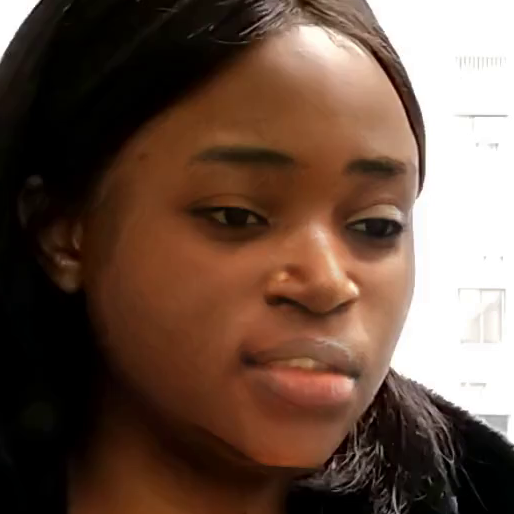

In [29]:
dataset_folder = "/d/hpc/projects/FRI/ldragar/dataset/"
#choose random  video frame from submission test1
import random
from plotly.subplots import make_subplots

random_video = submission.fn1[ random.randint(0, len(submission.fn1)-1) ]
name = random_video
print(name)
#open this folder and choose the first frame
import os
print(dataset_folder+random_video+"/")
#get all frames
frames = os.listdir(dataset_folder+random_video+"/")
#sort frames
frames.sort()

#print(frames)

print(random_video)
#get coresponding groundtruth
groundtruth = competition_end_groundthrought.mapping[name]
print(groundtruth)

#show picture
from PIL import Image
Image.open(dataset_folder+random_video+"/"+frames[0])





/d/hpc/projects/FRI/ldragar/dataset/C3/9-2-8-submit-92584.mp4/
C3/9-2-8-submit-92584.mp4
2.2


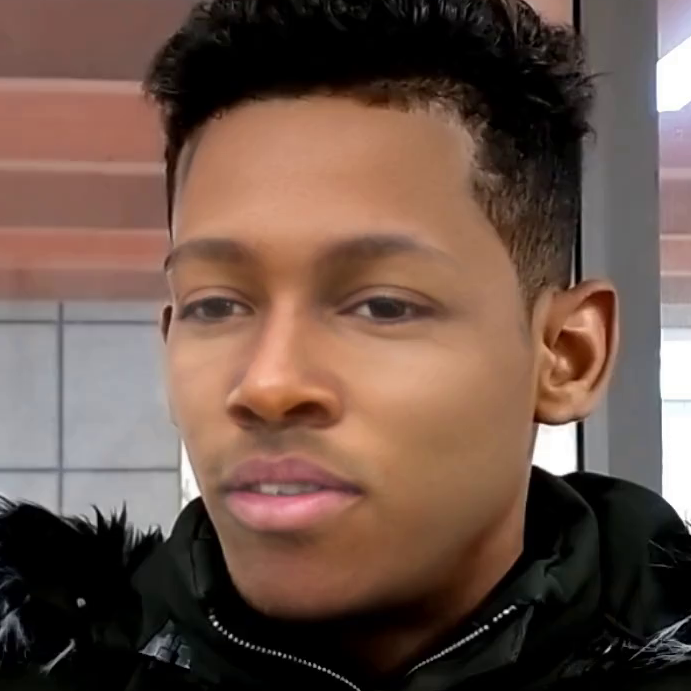

In [26]:
dataset_folder = "/d/hpc/projects/FRI/ldragar/dataset/"
#choose random  video frame from submission test1
import random
from plotly.subplots import make_subplots

random_video2 = submission.fn2[ random.randint(0, len(submission.fn2)-1) ]
name = random_video2
#open this folder and choose the first frame
import os
print(dataset_folder+random_video2+"/")
#get all frames
frames = os.listdir(dataset_folder+random_video2+"/")
#sort frames
frames.sort()

#print(frames)

print(random_video2)
#get coresponding groundtruth
groundtruth = competition_end_groundthrought.mapping[name]
print(groundtruth)

#show picture
from PIL import Image
Image.open(dataset_folder+random_video2+"/"+frames[0])





In [35]:
import plotly.graph_objects as go
import plotly.express as px

#plot the mos score distribution of fn1 and fn2 and fn3
mos_fn1 = [competition_end_groundthrought.mapping[x] for x in competition_end_groundthrought.fn1]
mos_fn2 = [competition_end_groundthrought.mapping[x] for x in competition_end_groundthrought.fn2]
mos_fn3 = [competition_end_groundthrought.mapping[x] for x in competition_end_groundthrought.fn3]



fig = go.Figure()
fig.add_trace(go.Histogram(x=mos_fn1, name="fn1"))
fig.add_trace(go.Histogram(x=mos_fn2, name="fn2"))
fig.add_trace(go.Histogram(x=mos_fn3, name="fn3"))

fig.show()

#calc box plots for confidence intervals beetwen convnext and eva






In [ ]:
mos_fn1

In [ ]:
#

In [6]:
import os
import plotly.graph_objects as go
from PIL import Image

sotred_mapping = sorted(competition_end_groundthrought.mapping.items(), key=lambda x: x[1], reverse=True)


In [17]:
# Find the lowest rated image

def get_picture(name):
    frames = os.listdir(dataset_folder + name + "/")
    frames.sort()
    if len(frames) <= 122:
        closest_frame = frames[-1]
        print(f"Warning: {name} has less than 123 frames. Choosing the closest frame: {closest_frame}")
    else:
        closest_frame = frames[122]
    return dataset_folder + name + "/" + closest_frame


def get_prediction(name):
    return submission.mapping[name]

filtered_mapping = [item for item in sotred_mapping if "15-1" in item[0]]
sotred_mapping = filtered_mapping

# Sort the filtered mapping
sotred_mapping = sorted(sotred_mapping, key=lambda x: x[1], reverse=True)
# Show the lowest rated image
fig = go.Figure()
fig.add_trace(go.Image(z=Image.open(get_picture(sotred_mapping[0][0]))))
fig.update_layout(title=f"Lowest rated image {sotred_mapping[0][0]} with score {sotred_mapping[0][1]}")
fig.show()
# Show a gallery of the top 10 highest rated images
best_10 = sotred_mapping[:20]

# fig = make_subplots(rows=4, cols=5, subplot_titles=[f"gt {x[1]}  pred: {round(get_prediction(x[0]),2)}" for x in best_10])
# for i in range(20):
#     fig.add_trace(go.Image(z=Image.open(get_picture(best_10[i][0]))), row=(i//5)+1, col=(i%5)+1)

# fig.show()

In [18]:
print(sotred_mapping[:20])

#save to folder named vis
if os.path.exists("vis"):
    os.system("rm -r vis")
os.mkdir("vis")

for key,value in sotred_mapping:
    print(key)

    #save as image in vis folder as name 
    Image.open(get_picture(key)).save("vis/gt"+str(value)+"_pred"+str(round(get_prediction(key),2))+".png")





[('C2/15-1-4-submit-82501.mp4', 4.2), ('C2/15-1-4-submit-82910.mp4', 4.0), ('C3/15-1-8-submit-92068.mp4', 4.0), ('C3/15-1-8-submit-92069.mp4', 4.0), ('C3/15-1-8-submit-93059.mp4', 4.0), ('C1/15-1-2-submit-73549.mp4', 3.8), ('C2/15-1-4-submit-83619.mp4', 3.8), ('C3/15-1-8-submit-91740.mp4', 3.8), ('C3/15-1-8-submit-93056.mp4', 3.8), ('C3/15-1-8-submit-93062.mp4', 3.8), ('C3/15-1-8-submit-93065.mp4', 3.8), ('C2/15-1-4-submit-83609.mp4', 3.8), ('C2/15-1-4-submit-82495.mp4', 3.6), ('C2/15-1-4-submit-82882.mp4', 3.6), ('C2/15-1-4-submit-83063.mp4', 3.6), ('C2/15-1-4-submit-82511.mp4', 3.6), ('C2/15-1-4-submit-83496.mp4', 3.6), ('C3/15-1-8-submit-92147.mp4', 3.6), ('C3/15-1-8-submit-92582.mp4', 3.4), ('C3/15-1-8-submit-00000.mp4', 3.4)]
C2/15-1-4-submit-82501.mp4
C2/15-1-4-submit-82910.mp4
C3/15-1-8-submit-92068.mp4
C3/15-1-8-submit-92069.mp4
C3/15-1-8-submit-93059.mp4
C1/15-1-2-submit-73549.mp4
C2/15-1-4-submit-83619.mp4
C3/15-1-8-submit-91740.mp4
C3/15-1-8-submit-93056.mp4
C3/15-1-8-submit